<a href="https://colab.research.google.com/github/ashishthomaschempolil/Medical-Image-Captioning-on-Chest-X-rays/blob/main/3_Attention_Model_Medical_Report.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
image_folder = '/content/drive/My Drive/Medical image Reporting/Images'
folder_name = '/content/drive/MyDrive/Medical image Reporting/pickle_files'
tr_file_name = 'train.pkl'
te_file_name = 'test.pkl'
chexnet_weights = '/content/drive/My Drive/Medical image Reporting/ChexNet weights/brucechou1983_CheXNet_Keras_0.3.0_weights.h5'

In [2]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import joblib #for saving model files as pkl files
import os
import seaborn as sns
import cv2
import imgaug.augmenters as iaa
sns.set(palette='muted',style='white')
import tensorflow as tf
from tensorflow.keras.layers import Dense,GlobalAveragePooling2D, Input, Embedding, LSTM,Dot,Reshape,Concatenate,BatchNormalization, GlobalMaxPooling2D, Dropout, Add, MaxPooling2D, GRU, AveragePooling2D
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from nltk.translate.bleu_score import sentence_bleu #bleu score
tf.compat.v1.enable_eager_execution()
import os
import math

In [3]:
train = pd.read_pickle(os.path.join(folder_name,tr_file_name))
test = pd.read_pickle(os.path.join(folder_name,te_file_name))
train.shape,test.shape

((5403, 7), (1443, 7))

In [4]:
#tokenizer
tokenizer = Tokenizer(filters = '',oov_token = '<unk>') #setting filters to none
tokenizer.fit_on_texts(train.impression_final.values)
train_captions = tokenizer.texts_to_sequences(train.impression_final) 
test_captions = tokenizer.texts_to_sequences(test.impression_final) 
vocab_size = len(tokenizer.word_index)
caption_len = np.array([len(i) for i in train_captions])
start_index = tokenizer.word_index['<cls>'] #tokened value of <cls>
end_index = tokenizer.word_index['<end>'] #tokened value of <end>

print('\nThe max and min value of "caption length" was found to be %i and %i respectively'%(max(caption_len),min(caption_len)))
print('The 95 percentile value of caption_len which is %i will be taken as the maximum padded value for each impression'%(np.percentile(caption_len,95)))
max_pad = int(np.percentile(caption_len,95))
del train_captions,test_captions #we will create tokenizing  and padding in-built in dataloader


The max and min value of "caption length" was found to be 135 and 4 respectively
The 95 percentile value of caption_len which is 49 will be taken as the maximum padded value for each impression


# **Modelling**

## **Hyperparameters**

In [5]:
batch_size = 100
embedding_dim = 300
dense_dim = 512
lstm_units = dense_dim
dropout_rate = 0.2

## **Creating an input data pipeline**

In [6]:
class Dataset():
  #here we will get the images converted to vector form and the corresponding captions
  def __init__(self,df,input_size,tokenizer = tokenizer, augmentation = True,max_pad = max_pad): 
    """
    df  = dataframe containing image_1,image_2 and impression
    """
    self.image1 = df.image_1
    self.image2 = df.image_2
    self.caption = df.impression_ip #inp
    self.caption1 = df.impression_op  #output
    self.input_size = input_size #tuple ex: (512,512)
    self.tokenizer = tokenizer
    self.augmentation = augmentation
    self.max_pad = max_pad

    #image augmentation
    #https://imgaug.readthedocs.io/en/latest/source/overview/flip.html?highlight=Fliplr
    self.aug1 = iaa.Fliplr(1) #flip images horizaontally
    self.aug2 = iaa.Flipud(1) #flip images vertically

    # https://imgaug.readthedocs.io/en/latest/source/overview/convolutional.html?highlight=emboss#emboss
    self.aug3 = iaa.Emboss(alpha=(1), strength=1) #embosses image

    #https://imgaug.readthedocs.io/en/latest/source/api_augmenters_convolutional.html?highlight=sharpen#imgaug.augmenters.convolutional.Sharpen
    self.aug4 = iaa.Sharpen(alpha=(1.0), lightness=(1.5)) #sharpens the image and apply some lightness/brighteness 1 means fully sharpened etc

  def __getitem__(self,i):
    #gets the datapoint at i th index, we will extract the feature vectors of images after resizing the image  and apply augmentation
    image1 = cv2.imread(self.image1[i],cv2.IMREAD_UNCHANGED)/255 
    image2 = cv2.imread(self.image2[i],cv2.IMREAD_UNCHANGED)/255 #here there are 3 channels
    image1 = cv2.resize(image1,self.input_size,interpolation = cv2.INTER_NEAREST)
    image2 = cv2.resize(image2,self.input_size,interpolation = cv2.INTER_NEAREST)
    if image1.any()==None:
      print("%i , %s image sent null value"%(i,self.image1[i]))
    if image2.any()==None:
      print("%i , %s image sent null value"%(i,self.image2[i]))


    #tokenizing and padding
    caption = self.tokenizer.texts_to_sequences(self.caption[i:i+1]) #the input should be an array for tokenizer ie [self.caption[i]] 

    caption = pad_sequences(caption,maxlen = self.max_pad,padding = 'post') #opshape:(input_length,)
    caption = tf.squeeze(caption,axis=0) #opshape = (input_length,) removing unwanted axis if present

    caption1 = self.tokenizer.texts_to_sequences(self.caption1[i:i+1]) #the input should be an array for tokenizer ie [self.caption[i]] 

    caption1 = pad_sequences(caption1,maxlen = self.max_pad,padding = 'post') #opshape: (input_length,)
    caption1 = tf.squeeze(caption1,axis=0) #opshape = (input_length,) removing unwanted axis if present




    if self.augmentation: #we will not apply augmentation that crops the image 
          a = np.random.uniform()
          if a<0.2:
              image1 = self.aug1.augment_image(image1)
              image2 = self.aug1.augment_image(image2)
          elif a<0.4:
              image1 = self.aug2.augment_image(image1)
              image2 = self.aug2.augment_image(image2)
          elif a<0.6:
              image1 = self.aug3.augment_image(image1)
              image2 = self.aug3.augment_image(image2)
          elif a<0.8:
              image1 = self.aug4.augment_image(image1)
              image2 = self.aug4.augment_image(image2)
          else: #applying no augmentation
            pass;

    
    return image1,image2,caption,caption1

    
  def __len__(self):
    return len(self.image1)


class Dataloader(tf.keras.utils.Sequence):     #for batching
    def __init__(self, dataset, batch_size=1, shuffle=True):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(self.dataset))

    def __getitem__(self, i):
        
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = [self.dataset[j] for j in range(start,stop)] #taken from Data class (calls __getitem__ of Data) here the shape is batch_size*3, (image_1,image_2,caption)
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)] #here the shape will become batch_size*input_size(of image)*3,batch_size*input_size(of image)*3
                                                                      #,batch_size*1*max_pad


        return tuple([[batch[0],batch[1],batch[2]],batch[3]]) #here [image1,image2, caption(without <END>)],caption(without <CLS>) (op)
    
    def __len__(self): #returns total number of batches in an epoch
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self): #it runs at the end of epoch
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [7]:
input_size = (224,224)
train_dataloader = Dataset(train,input_size)
train_dataloader = Dataloader(train_dataloader,batch_size = batch_size)

test_dataloader = Dataset(test,input_size)
test_dataloader = Dataloader(test_dataloader,batch_size = batch_size)

## **CHeXNET Model (pretrained)**

[CheXNET Model](https://arxiv.org/pdf/1711.05225.pdf) is a Denset121 layered model which is trained on 1000s of chest x-ray images for the classification of 14 diseases.We can load the weights of that model and pass the image through that model. The top layer will be ignore.

In [8]:
#chexnet weights ; https://drive.google.com/file/d/19BllaOvs2x5PLV_vlWMy4i8LapLb2j6b/view
def create_chexnet(chexnet_weights = chexnet_weights,input_size = input_size):
  """
  chexnet_weights: weights value in .h5 format of chexnet
  creates a chexnet model with preloaded weights present in chexnet_weights file
  """
  model = tf.keras.applications.DenseNet121(include_top=False,input_shape = input_size+(3,)) #importing densenet the last layer will be a relu activation layer

  #we need to load the weights so setting the architecture of the model as same as the one of tha chexnet
  x = model.output #output from chexnet
  x = GlobalAveragePooling2D()(x)
  x = Dense(14, activation="sigmoid", name="chexnet_output")(x) #here activation is sigmoid as seen in research paper

  chexnet = tf.keras.Model(inputs = model.input,outputs = x)
  chexnet.load_weights(chexnet_weights)
  chexnet = tf.keras.Model(inputs = model.input,outputs = chexnet.layers[-3].output)  #we will be taking the 3rd last layer (here it is layer before global avgpooling)
  #since we are using attention here
  return chexnet

## Attention Model

References:
[attention](https://lilianweng.github.io/lil-log/2018/06/24/attention-attention.html)

In [9]:
embedding_dim = 300
dense_dim = 512
lstm_units = dense_dim
dropout_rate = 0.2

### Image Encoder Layer

In [10]:
class Image_encoder(tf.keras.layers.Layer):
  """
  This layer will output image backbone features after passing it through chexnet
  here chexnet will be not be trainable
  """
  def __init__(self,
               name = "image_encoder_block"
               ):
    super().__init__()
    self.chexnet = create_chexnet()
    self.chexnet.trainable = False
    self.maxpool = AveragePooling2D()
    # for i in range(10): #the last 10 layers of chexnet will be trained
    #   self.chexnet.layers[-i].trainable = True
    
  def call(self,data):
    op = self.chexnet(data) #op shape: (None,7,7,1024)
    op = self.maxpool(op) #op shape (None,3,3,1024)
    op = tf.reshape(op,shape = (-1,op.shape[1]*op.shape[2],op.shape[3])) #op shape: (None,98,1024)
    return op 

### Encoder

In [11]:
def encoder(image1,image2,dense_dim = dense_dim,dropout_rate = dropout_rate):
  """
  Takes image1,image2
  gets the final encoded vector of these
  """
  #image1
  bkfeat1 = Image_encoder()(image1) #shape: (None,49,1024)
  bkfeat1 = Dense(dense_dim,name = 'bkdense1',activation = 'relu')(bkfeat1)

  #image2
  bkfeat2 = Image_encoder()(image2) #shape: (None,49,1024)
  bkfeat2 = Dense(dense_dim,name = 'bkdense2',activation = 'relu')(bkfeat2)


  #combining image1 and image2
  concat = Concatenate(axis=1)([bkfeat1,bkfeat2]) #concatenating through the second axis shape: (None,98,1024)

  # dense = Dense(dense_dim,name = 'encoder_final_dense',activation = 'relu')(concat) #shape: (None,98,512)
  bn = BatchNormalization(name = "encoder_batch_norm")(concat) #(dense)#
  dropout = Dropout(dropout_rate,name = "encoder_dropout")(bn)
  return dropout

Global Attention equations



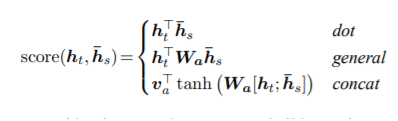

Here I will be using general score of global attention.
[reference](https://github.com/uzaymacar/attention-mechanisms#local-attention)

### Global Attention Layer

In [12]:
class global_attention(tf.keras.layers.Layer):
  """
  calculate global attention
  """
  def __init__(self,dense_dim = dense_dim):
    super().__init__()
    # Intialize variables needed for Concat score function here
    self.W1 = Dense(units = dense_dim) #weight matrix of shape enc_units*dense_dim
    self.W2 = Dense(units = dense_dim) #weight matrix of shape dec_units*dense_dim
    self.V = Dense(units = 1) #weight matrix of shape dense_dim*1 
      #op (None,98,1)


  def call(self,encoder_output,decoder_h): #here the encoded output will be the concatted image bk features shape: (None,98,dense_dim)
    decoder_h = tf.expand_dims(decoder_h,axis=1) #shape: (None,1,dense_dim)
    tanh_input = self.W1(encoder_output) + self.W2(decoder_h) #ouput_shape: batch_size*98*dense_dim
    tanh_output =  tf.nn.tanh(tanh_input)
    attention_weights = tf.nn.softmax(self.V(tanh_output),axis=1) #shape= batch_size*98*1 getting attention alphas
    op = attention_weights*encoder_output#op_shape: batch_size*98*dense_dim  multiply all aplhas with corresponding context vector
    context_vector = tf.reduce_sum(op,axis=1) #summing all context vector over the time period ie input length, output_shape: batch_size*dense_dim


    return context_vector,attention_weights


In [13]:
glove = {}
with open('/content/drive/My Drive/glove_vectors/glove.6B.300d.txt',encoding='utf-8') as f: #taking 300 dimesions
  for line in f:
    word = line.split() #it is stored as string like this "'the': '.418 0.24968 -0.41242 0.1217 0.34527 -0.044457 -0.4"
    glove[word[0]] = np.asarray(word[1:], dtype='float32')


embedding_dim = 300
# create a weight matrix for words in training docs for embedding purpose
embedding_matrix = np.zeros((vocab_size+1, embedding_dim)) #https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding

for word, i in tokenizer.word_index.items():
  embedding_vector = glove.get(word)
  if embedding_vector is not None: #if the word is found in glove vectors
      embedding_matrix[i] = embedding_vector[:embedding_dim]

### One Step Decoder

In [14]:
class One_Step_Decoder(tf.keras.layers.Layer):
  """
  decodes a single token
  """
  def __init__(self,vocab_size = vocab_size, embedding_dim = embedding_dim, max_pad = max_pad, dense_dim = dense_dim ,name = "onestepdecoder"):
    # Initialize decoder embedding layer, LSTM and any other objects needed
    super().__init__()
    self.dense_dim = dense_dim
    self.embedding = Embedding(input_dim = vocab_size+1,
                                output_dim = embedding_dim,
                                input_length=max_pad,
                                weights = [embedding_matrix],
                                mask_zero=True, 
                                name = 'onestepdecoder_embedding'
                              )
    self.LSTM = GRU(units=self.dense_dim,
                    # return_sequences=True,
                    return_state=True,
                    name = 'onestepdecoder_LSTM'
                    )
    self.attention = global_attention(dense_dim = dense_dim)
    self.concat = Concatenate(axis=-1)
    self.dense = Dense(dense_dim,name = 'onestepdecoder_embedding_dense',activation = 'relu')
    self.final = Dense(vocab_size+1,activation='softmax')
    self.concat = Concatenate(axis=-1)
    self.add =Add()
  @tf.function
  def call(self,input_to_decoder, encoder_output, decoder_h):#,decoder_c):
    '''
        One step decoder mechanisim step by step:
      A. Pass the input_to_decoder to the embedding layer and then get the output(batch_size,1,embedding_dim)
      B. Using the encoder_output and decoder hidden state, compute the context vector.
      C. Concat the context vector with the step A output
      D. Pass the Step-C output to LSTM/GRU and get the decoder output and states(hidden and cell state)
      E. Pass the decoder output to dense layer(vocab size) and store the result into output.
      F. Return the states from step D, output from Step E, attention weights from Step -B

      here state_h,state_c are decoder states
    '''
    embedding_op = self.embedding(input_to_decoder) #output shape = batch_size*1*embedding_shape (only 1 token)
    # embedding_op = self.dense(embedding_op)

    context_vector,attention_weights = self.attention(encoder_output,decoder_h) #passing hidden state h of decoder and encoder output
    #context_vector shape: batch_size*dense_dim we need to add time dimension
    context_vector_time_axis = tf.expand_dims(context_vector,axis=1)
    #now we will combine arrention output context vector with next word input to the lstm here we will be teacher forcing
    concat_input = self.concat([context_vector_time_axis,embedding_op])#output dimension = batch_size*input_length(here it is 1)*(dense_dim+embedding_dim)
    # concat_input = self.add([context_vector_time_axis,embedding_op])
    # output,decoder_h,decoder_c = self.LSTM(concat_input,initial_state = [decoder_h,decoder_c])
    output,decoder_h = self.LSTM(concat_input,initial_state = decoder_h)
    #output shape = batch*1*dense_dim and decoder_h,decoder_c has shape = batch*dense_dim
    #we need to remove the time axis from this decoder_output
    # output = tf.squeeze(decoder_output,axis=1)

    output = self.final(output)#shape = batch_size*decoder vocab size
    return output,decoder_h,attention_weights #decoder_c,

### Decoder

In [15]:
class decoder(tf.keras.Model):
  """
  Decodes the encoder output and caption
  """
  def __init__(self,max_pad = max_pad, embedding_dim = embedding_dim,dense_dim = dense_dim,score_fun='general',batch_size = batch_size,vocab_size = vocab_size):
    super().__init__()
    self.onestepdecoder = One_Step_Decoder(vocab_size = vocab_size, embedding_dim = embedding_dim, max_pad = max_pad, dense_dim = dense_dim)
    self.output_array = tf.TensorArray(tf.float32,size=max_pad)
    self.max_pad = max_pad
    self.batch_size = batch_size
    self.dense_dim =dense_dim
    
  @tf.function
  def call(self,encoder_output,caption):#,decoder_h,decoder_c): #caption : (None,max_pad), encoder_output: (None,dense_dim)
    decoder_h, decoder_c = tf.zeros_like(encoder_output[:,0]), tf.zeros_like(encoder_output[:,0]) #decoder_h, decoder_c
    output_array = tf.TensorArray(tf.float32,size=max_pad)
    for timestep in range(self.max_pad): #iterating through all timesteps ie through max_pad
      # output,decoder_h,decoder_c,attention_weights = self.onestepdecoder(caption[:,timestep:timestep+1], encoder_output, decoder_h,decoder_c)
      output,decoder_h,attention_weights = self.onestepdecoder(caption[:,timestep:timestep+1], encoder_output, decoder_h)
      output_array = output_array.write(timestep,output) #timestep*batch_size*vocab_size

    self.output_array = tf.transpose(output_array.stack(),[1,0,2]) #.stack :Return the values in the TensorArray as a stacked Tensor.)
        #shape output_array: (batch_size,max_pad,vocab_size)
    return self.output_array

### Global Attention Model

In [16]:
#model creation
tf.keras.backend.clear_session()
image1 = Input(shape = (input_size + (3,))) #shape = 224,224,3
image2 = Input(shape = (input_size + (3,))) #https://www.w3resource.com/python-exercises/tuple/python-tuple-exercise-5.php
caption = Input(shape = (max_pad,))

encoder_output = encoder(image1,image2) #shape: (None,28,512)

output = decoder()(encoder_output,caption)

model = tf.keras.Model(inputs = [image1,image2,caption], outputs = output)

29089792/29084464 [==============================] - 0s 0us/step


In [17]:
model.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
image_encoder (Image_encoder)   (None, 9, 1024)      7037504     input_1[0][0]                    
__________________________________________________________________________________________________
image_encoder_1 (Image_encoder) (None, 9, 1024)      7037504     input_2[0][0]                    
____________________________________________________________________________________________

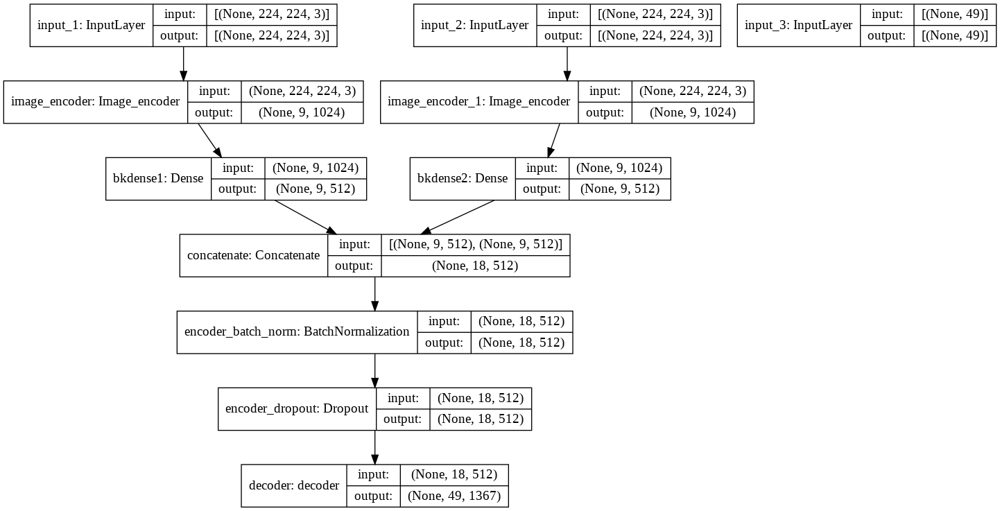

In [18]:
tf.keras.utils.plot_model(model,
                          show_shapes = True
                          )

In [19]:
loss_func = tf.keras.losses.SparseCategoricalCrossentropy() 

def custom_loss(y_true, y_pred):
    #getting mask value to not consider those words which are not present in the true caption
    mask = tf.math.logical_not(tf.math.equal(y_true, 0))

    #y_pred = y_pred+10**-7 #to prevent loss becoming null

    #calculating the loss
    loss_ = loss_func(y_true, y_pred)
    
    #converting mask dtype to loss_ dtype
    mask = tf.cast(mask, dtype=loss_.dtype)
    
    #applying the mask to loss
    loss_ = loss_*mask
    
    #returning mean over all the values
    return tf.reduce_mean(loss_)

lr = 10**-3
optimizer = tf.keras.optimizers.Adam(learning_rate = lr)   
model.compile(optimizer=optimizer,loss=custom_loss,metrics= ['accuracy'])
# model.compile(optimizer=optimizer,loss=tf.keras.losses.SparseCategoricalCrossentropy() ,metrics= ['accuracy'])

In [20]:
tf.keras.backend.clear_session()
tb_filename = 'Encoder_Decoder_global_attention/'
tb_file = os.path.join('/content/drive/My Drive/Medical image Reporting',tb_filename)
model_filename = 'Encoder_Decoder_global_attention.h5'
model_save = os.path.join('/content/drive/My Drive/Medical image Reporting',model_filename)
my_callbacks = [
    tf.keras.callbacks.EarlyStopping(patience = 5,
                                     verbose = 2
                                     ),
    tf.keras.callbacks.ModelCheckpoint(filepath=model_save,
                                       save_best_only = True,
                                      save_weights_only = True,
                                       verbose = 2
                                       ),
    tf.keras.callbacks.TensorBoard(histogram_freq=1,
                                   log_dir=tb_file),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1,
                              patience=2, min_lr=10**-7, verbose = 2)
                                   
] #from keras documentation

In [21]:
!rm -r '/content/drive/My Drive/Medical image Reporting/Encoder_Decoder_global_attention/'

In [22]:
model.fit(train_dataloader,
          validation_data = test_dataloader,
          epochs = 10,
          callbacks = my_callbacks
          )

Epoch 1/10
54/54 [==============================] - 3217s 58s/step - loss: 2.3333 - accuracy: 0.6056 - val_loss: 1.1817 - val_accuracy: 0.9076

Epoch 00001: val_loss improved from inf to 1.18169, saving model to /content/drive/My Drive/Medical image Reporting/Encoder_Decoder_global_attention.h5
Epoch 2/10
54/54 [==============================] - 151s 3s/step - loss: 2.1198 - accuracy: 0.7564 - val_loss: 1.1396 - val_accuracy: 0.9180

Epoch 00002: val_loss improved from 1.18169 to 1.13964, saving model to /content/drive/My Drive/Medical image Reporting/Encoder_Decoder_global_attention.h5
Epoch 3/10
54/54 [==============================] - 151s 3s/step - loss: 2.0249 - accuracy: 0.7796 - val_loss: 1.1125 - val_accuracy: 0.9253

Epoch 00003: val_loss improved from 1.13964 to 1.11249, saving model to /content/drive/My Drive/Medical image Reporting/Encoder_Decoder_global_attention.h5
Epoch 4/10
54/54 [==============================] - 150s 3s/step - loss: 1.7928 - accuracy: 0.8247 - val_los

### Tensorboard

In [21]:
model_filename = 'Encoder_Decoder_global_attention.h5'
model_save = os.path.join('/content/drive/My Drive/Medical image Reporting',model_filename)
model1 = tf.keras.Model(inputs = [image1,image2,caption], outputs = output)
model1.load_weights(model_save)

In [22]:
%load_ext tensorboard

In [23]:
%tensorboard --logdir '/content/drive/My Drive/Medical image Reporting/Encoder_Decoder_global_attention/'

<IPython.core.display.Javascript object>

## Predictions

### Bleu score function

We will compute bleu scores 1-gram,2-gram, 3-gram and 4-gram for each sentence.

In [24]:
def get_bleu(reference,prediction):
  """
  Given a reference and prediction string, outputs the 1-gram,2-gram,3-gram and 4-gram bleu scores
  """
  reference = [reference.split()] #should be in an array (cos of multiple references can be there here only 1)
  prediction = prediction.split()
  bleu1 = sentence_bleu(reference,prediction,weights = (1,0,0,0),)
  bleu2 = sentence_bleu(reference,prediction,weights = (0.5,0.5,0,0))
  bleu3 = sentence_bleu(reference,prediction,weights = (0.33,0.33,0.33,0))
  bleu4 = sentence_bleu(reference,prediction,weights = (0.25,0.25,0.25,0.25))

  return bleu1,bleu2,bleu3,bleu4

In [25]:
#calculate bleu scores for every datapoint
def mean_bleu(test,predict,model=model1,**kwargs):
  """
  given a df and predict fucntion which predicts the impression of the caption
  outpus the mean bleu1,bleu2,bleu3, bleu4 for entire datapoints in df
  """
  if kwargs!=None:
    top_k = kwargs.get('top_k')
  else:
    top_k = None
  bleu1,bleu2,bleu3,bleu4 = [],[],[],[]
  for index,data in test.iterrows():
    if top_k==None:
      predict_val = predict(data['image_1'],data['image_2'],model = model) #predicted sentence
    else:
      predict_val = predict(data['image_1'],data['image_2'],model = model,top_k = top_k)
    true = data.impression
    _ = get_bleu(true,predict_val)
    bleu1.append(_[0])
    bleu2.append(_[1])
    bleu3.append(_[2])
    bleu4.append(_[3])
  return np.array(bleu1).mean(),np.array(bleu2).mean(),np.array(bleu3).mean(),np.array(bleu4).mean()

### **Greedy Search**

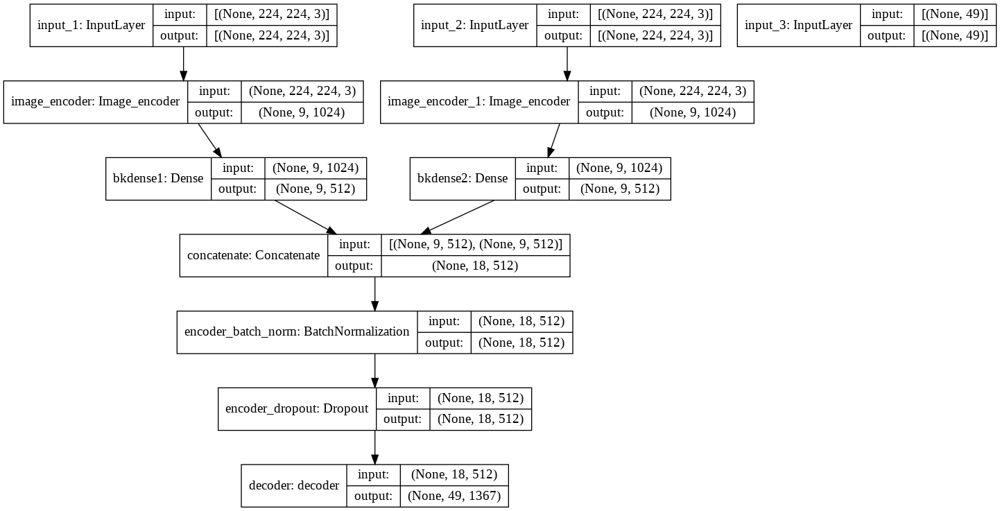

In [26]:
def greedy_search_predict(image1,image2,model = model1):
  """
  Given paths to two x-ray images predicts the impression part of the x-ray in a greedy search algorithm
  """
  image1 = cv2.imread(image1,cv2.IMREAD_UNCHANGED)/255 
  image2 = cv2.imread(image2,cv2.IMREAD_UNCHANGED)/255 
  image1 = tf.expand_dims(cv2.resize(image1,input_size,interpolation = cv2.INTER_NEAREST),axis=0) #introduce batch and resize
  image2 = tf.expand_dims(cv2.resize(image2,input_size,interpolation = cv2.INTER_NEAREST),axis=0)
  image1 = model.get_layer('image_encoder')(image1)
  image2 = model.get_layer('image_encoder_1')(image2)
  image1 = model.get_layer('bkdense1')(image1)
  image2 = model.get_layer('bkdense2')(image2)

  concat = model.get_layer('concatenate')([image1,image2])
  # enc_op = model.get_layer('encoder_final_dense')(concat)
  enc_op = model.get_layer('encoder_batch_norm')(concat)  #(enc_op)
  enc_op = model.get_layer('encoder_dropout')(enc_op) #this is the output from encoder


  decoder_h,decoder_c = tf.zeros_like(enc_op[:,0]),tf.zeros_like(enc_op[:,0])
  a = []
  pred = []
  for i in range(max_pad):
    if i==0: #if first word
      caption = np.array(tokenizer.texts_to_sequences(['<cls>'])) #shape: (1,1)
    output,decoder_h,attention_weights = model.get_layer('decoder').onestepdecoder(caption,enc_op,decoder_h)#,decoder_c) decoder_c,

    #prediction
    max_prob = tf.argmax(output,axis=-1)  #tf.Tensor of shape = (1,1)
    caption = np.array([max_prob]) #will be sent to onstepdecoder for next iteration
    if max_prob==np.squeeze(tokenizer.texts_to_sequences(['<end>'])): 
      break;
    else:
      a.append(tf.squeeze(max_prob).numpy())
  return tokenizer.sequences_to_texts([a])[0] #here output would be 1,1 so subscripting to open the array

In [27]:
%%time
_ = mean_bleu(test,greedy_search_predict)

CPU times: user 5min 45s, sys: 6.14 s, total: 5min 51s
Wall time: 30min 13s


In [28]:
k = list(_)
index = 'greedy search'
result = pd.DataFrame([k],columns = ["bleu1","bleu2","bleu3","bleu4"],index = [index])
result

,bleu1,bleu2,bleu3,bleu4
greedy search,0.48057,0.442533,0.471071,0.522529


### **Beam Search**

In [29]:
def get_predictions(image1,image2, model=model1):
  """
  given image 1 and image 2 and model, outputs prediction probabilities for each timestep upto chosen max pad of the model
  """
  image1 = cv2.imread(image1,cv2.IMREAD_UNCHANGED)/255 
  image2 = cv2.imread(image2,cv2.IMREAD_UNCHANGED)/255 
  image1 = tf.expand_dims(cv2.resize(image1,input_size,interpolation = cv2.INTER_NEAREST),axis=0) #introduce batch and resize
  image2 = tf.expand_dims(cv2.resize(image2,input_size,interpolation = cv2.INTER_NEAREST),axis=0)
  image1 = model.get_layer('image_encoder')(image1)
  image2 = model.get_layer('image_encoder_1')(image2)
  image1 = model.get_layer('bkdense1')(image1)
  image2 = model.get_layer('bkdense2')(image2)

  concat = model.get_layer('concatenate')([image1,image2])
  # enc_op = model.get_layer('encoder_final_dense')(concat)
  enc_op = model.get_layer('encoder_batch_norm')(concat) 
  enc_op = model.get_layer('encoder_dropout')(enc_op) #this is the output from encoder


  decoder_h,decoder_c = tf.zeros_like(enc_op[:,0]),tf.zeros_like(enc_op[:,0])
  a = []
  pred = []
  for i in range(max_pad):
    if i==0: #if first word
      caption = np.array(tokenizer.texts_to_sequences(['<cls>'])) #shape: (1,1)
    output,decoder_h,attention_weights = model.get_layer('decoder').onestepdecoder(caption,enc_op,decoder_h)#,decoder_c) decoder_c,

    #prediction
    max_prob = tf.argmax(output,axis=-1) #tf.Tensor of shape = (1,1)
    caption = np.array([max_prob]) #will be sent to onstepdecoder for next iteration
    if max_prob==np.squeeze(tokenizer.texts_to_sequences(['<end>'])): 
      break;
    else:
      pred.append(output.numpy().squeeze()) #pred stores prob of every op at every timestep ie pred[0]: all prob at timestep 0
  return pred

In [30]:
#https://towardsdatascience.com/boosting-your-sequence-generation-performance-with-beam-search-language-model-decoding-74ee64de435a
def beam_search_decoder(predictions, top_k = 3):
  """
  given prediction ie probabilities for each and every timestep, 
  gets the top 3 sequences with highest probability based on beam search
  """
    #start with an empty sequence with zero score
  output_sequences = [([], 0)]
  
  #looping through all the predictions
  for token_probs in predictions:
      new_sequences = []
      
      #append new tokens to old sequences and re-score
      for old_seq, old_score in output_sequences:
          for sent_index in range(len(token_probs)): #iterating for each word in the vocab
              new_seq = old_seq + [sent_index]
              #considering log-likelihood for scoring (here log is considered because the probs values will be very small)
              new_score = old_score + math.log(token_probs[sent_index])
              new_sequences.append((new_seq, new_score))
              
      #sort all new sequences in the de-creasing order of their score
      output_sequences = sorted(new_sequences, key = lambda val: val[1], reverse = True)
      
      #select top-k based on score 
      # *Note- best sequence is with the highest score her
      output_sequences = output_sequences[:top_k]
        
  return output_sequences

In [31]:
def beam_search_predict(image1,image2,top_k=7,model=model1):
  pred = get_predictions(image1,image2,model)
  op_sequences = beam_search_decoder(pred,top_k)
  sentence = tokenizer.sequences_to_texts([op_sequences[0][0]]) #contains sequence, score
  return sentence[0]

In [32]:
%%time
_ = mean_bleu(test,beam_search_predict)

CPU times: user 9min 15s, sys: 4.78 s, total: 9min 20s
Wall time: 9min 18s


In [33]:
k = list(_)
index = 'beam search (top_k = 3)'
temp = pd.DataFrame([k],columns = ["bleu1","bleu2","bleu3","bleu4"],index = [index])
result = result.append(temp)

In [34]:
%%time
_ = mean_bleu(test,beam_search_predict,top_k = 5)

CPU times: user 7min 59s, sys: 4.82 s, total: 8min 4s
Wall time: 8min 2s


In [35]:
k = list(_)
index = 'beam search (top_k = 5)'
temp = pd.DataFrame([k],columns = ["bleu1","bleu2","bleu3","bleu4"],index = [index])
result = result.append(temp)

In [36]:
%%time
_ = mean_bleu(test,beam_search_predict,top_k = 7)

CPU times: user 9min 14s, sys: 4.96 s, total: 9min 19s
Wall time: 9min 17s


In [37]:
k = list(_)
index = 'beam search (top_k = 7)'
temp = pd.DataFrame([k],columns = ["bleu1","bleu2","bleu3","bleu4"],index = [index])
result = result.append(temp)

In [38]:
result

,bleu1,bleu2,bleu3,bleu4
greedy search,0.48057,0.442533,0.471071,0.522529
beam search (top_k = 3),0.48057,0.442533,0.471071,0.522529
beam search (top_k = 5),0.48057,0.442533,0.471071,0.522529
beam search (top_k = 7),0.48057,0.442533,0.471071,0.522529


# **Inference**

In [39]:
def final_caption_pred(image1,image2,method = "beam",top_k = 3,model=model1):
  """
  Given image1. image2 paths, the model, top_k and the method of prediction returns the predicted caption
  method: "greedy" or "g" for greedy search, "beam" or "b" for beam search
  """
  if method in ['greedy','g']:
    pred_caption = greedy_search_predict(image1,image2,model)
  elif method in ['beam','b']:
    pred_caption = beam_search_predict(image1,image2,top_k = top_k,model = model)
  else:
    print("Enter 'b' or 'beam' for beam search and 'g' or 'greedy' for greedy search")
  
  return pred_caption

In [40]:
def inference(image1,image2,true_caption,model=model1,top_k = [3,5,7],image_size = (20,40)):
  """
  given 2 images (their paths), the true caption, the model and the range of top_k
  prints the two images, true caption along with greedy search prediction and beam search prediction of top_k range
  """
  image1_array = cv2.imread(image1,cv2.IMREAD_UNCHANGED)
  image2_array = cv2.imread(image2,cv2.IMREAD_UNCHANGED)
  if type(top_k)==int:
    top_k = [top_k] #changing it to list if top_k given is of int type
  greedy_caption = final_caption_pred(image1,image2,method='g',model=model) #getting the greedy search prediction

  #printing the 2 images
  plt.figure(figsize = image_size)
  plt.subplot(121)
  plt.imshow(image1_array)
  plt.axis("off")

  plt.subplot(122)
  plt.imshow(image2_array)
  plt.axis("off")
  plt.show()

  print("\nTrue caption: '%s'"%(true_caption))
  print("Predicted caption(greedy search): '%s'"%(greedy_caption))
  #beam search of top_k
  for i in top_k:
    beam_caption = final_caption_pred(image1,image2,method='b',model=model,top_k = i)
    print("Predicted caption(beam search = %i): '%s'"%(i,beam_caption))


## Correct Captions

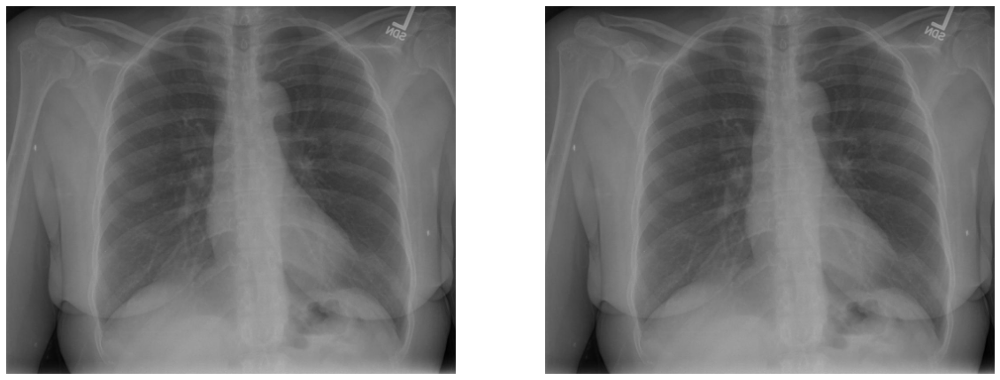


True caption: 'no acute abnormality .'
Predicted caption(greedy search): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 3): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 5): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 7): 'no acute cardiopulmonary abnormality .'


In [50]:
k = 1
image1,image2 = test['image_1'][k],test['image_2'][k]
true_caption = test['impression'][k]
inference(image1,image2,true_caption)

Even though the words are not the same but the meaning of the two sentence are similar.

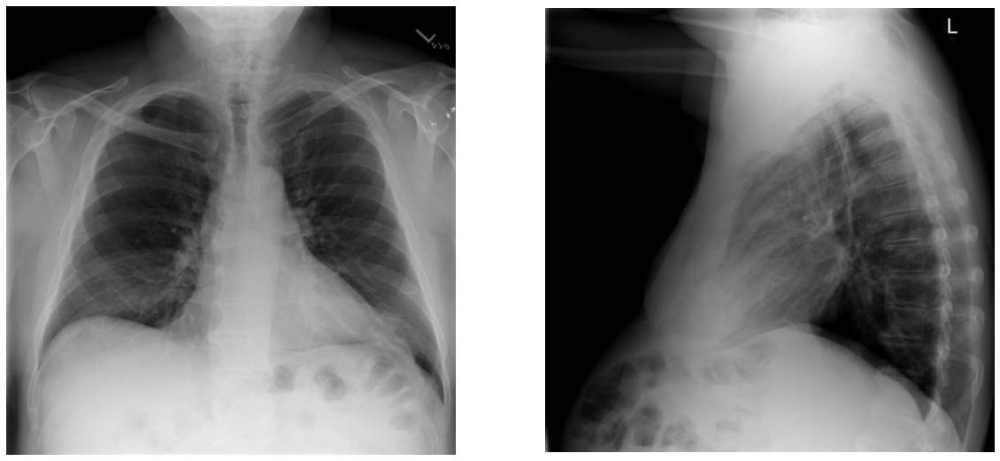


True caption: 'no acute cardiopulmonary abnormality .'
Predicted caption(greedy search): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 3): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 5): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 7): 'no acute cardiopulmonary abnormality .'


In [54]:
k = 25
image1,image2 = test['image_1'][k],test['image_2'][k]
true_caption = test['impression'][k]
inference(image1,image2,true_caption)

Here every model has predicted all of the word correctly.

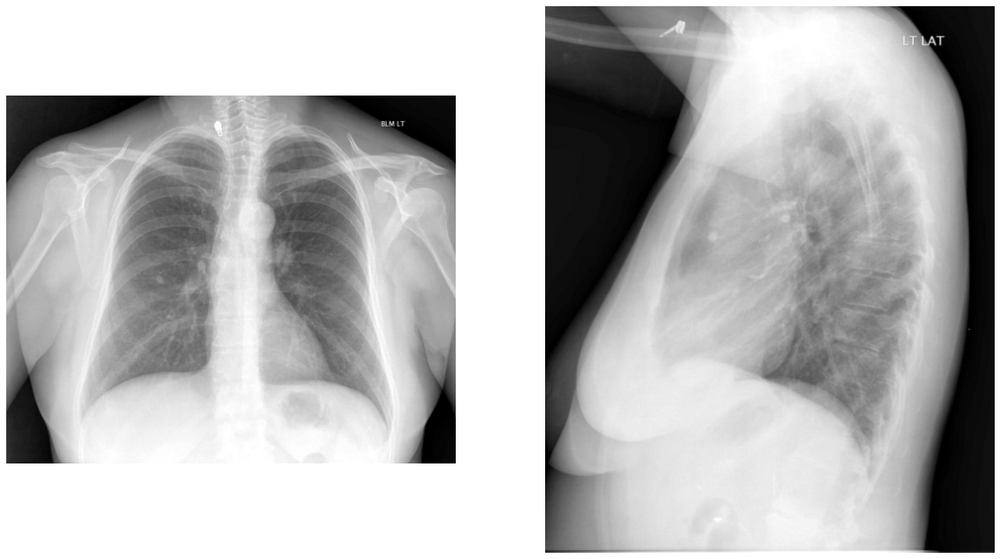


True caption: 'clear lungs .'
Predicted caption(greedy search): 'no acute cardiopulmonary disease . no evidence for metastatic disease by radiographic evaluation .'
Predicted caption(beam search = 3): 'no acute cardiopulmonary disease . no evidence for metastatic disease by radiographic evaluation .'
Predicted caption(beam search = 5): 'no acute cardiopulmonary disease . no evidence for metastatic disease by radiographic evaluation .'
Predicted caption(beam search = 7): 'no acute cardiopulmonary disease . no evidence for metastatic disease by radiographic evaluation .'


In [74]:
k = 1011
image1,image2 = test['image_1'][k],test['image_2'][k]
true_caption = test['impression'][k]
inference(image1,image2,true_caption)

Here we can see here that although the words in the true caption and predicted captions are different, the meaning of the sentence are the same ie no disease.

## Incorrect Captions

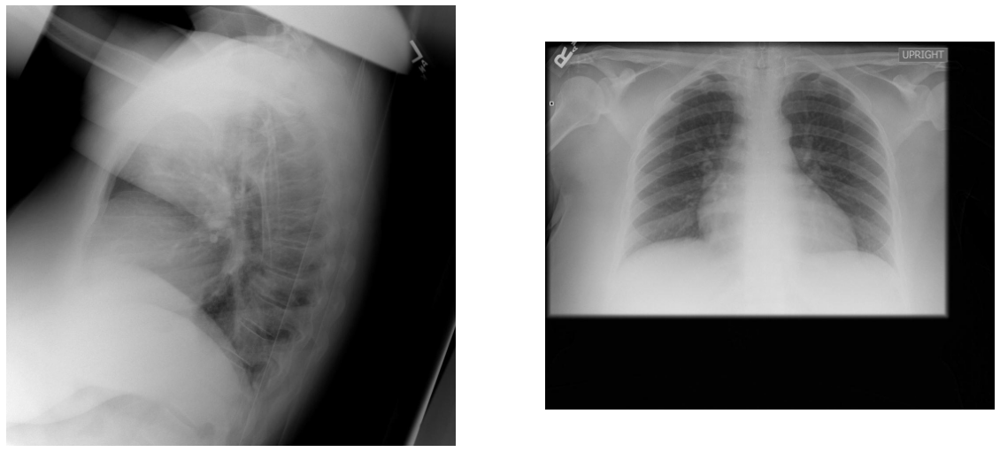


True caption: 'exam quality limited by hypoventilation and apical lordotic frontal projection . considering technical factors heart size at mildly enlarged . no focal alveolar consolidation no definite pleural effusion seen . bronchovascular crowding without typical findings of pulmonary edema .'
Predicted caption(greedy search): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 3): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 5): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 7): 'no acute cardiopulmonary abnormality .'


In [81]:
k = 1400
image1,image2 = test['image_1'][k],test['image_2'][k]
true_caption = test['impression'][k]
inference(image1,image2,true_caption)

The model got it all wrong.

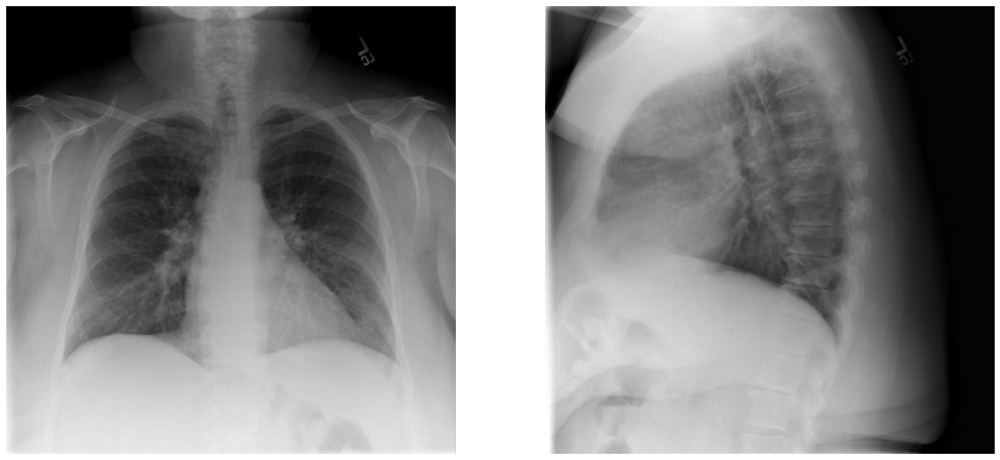


True caption: 'no focal airspace consolidation . mildly hyperexpanded lungs suggestive of obstructive lung disease .'
Predicted caption(greedy search): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 3): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 5): 'no acute cardiopulmonary abnormality .'
Predicted caption(beam search = 7): 'no acute cardiopulmonary abnormality .'


In [45]:
k = 1323
image1,image2 = test['image_1'][k],test['image_2'][k]
true_caption = test['impression'][k]
inference(image1,image2,true_caption)

Here also the same case as above.

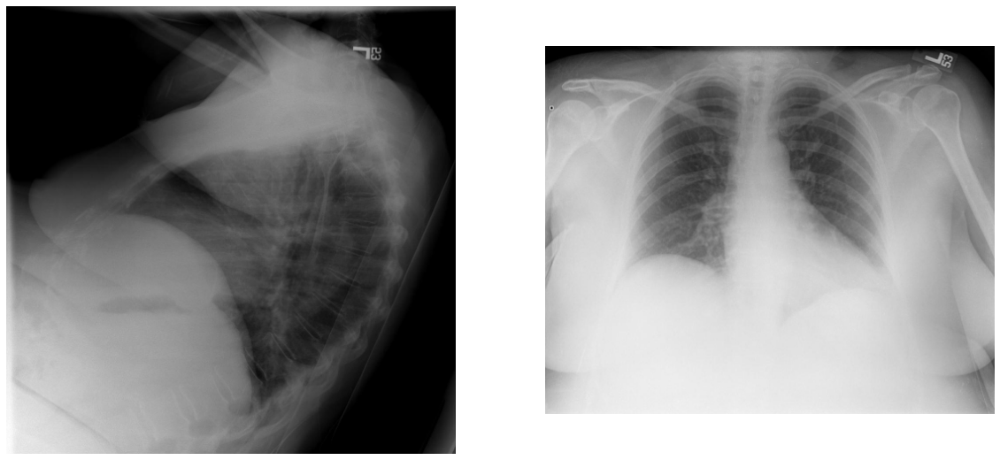


True caption: 'no acute cardiopulmonary disease .'
Predicted caption(greedy search): 'no acute cardiopulmonary abnormality . moderate cardiomegaly without pulmonary edema .'
Predicted caption(beam search = 3): 'no acute cardiopulmonary abnormality . moderate cardiomegaly without pulmonary edema .'
Predicted caption(beam search = 5): 'no acute cardiopulmonary abnormality . moderate cardiomegaly without pulmonary edema .'
Predicted caption(beam search = 7): 'no acute cardiopulmonary abnormality . moderate cardiomegaly without pulmonary edema .'


In [75]:
k = 11
image1,image2 = test['image_1'][k],test['image_2'][k]
true_caption = test['impression'][k]
inference(image1,image2,true_caption)

This is somewhat true but the last sentence is wrong otherwise the meaning would have been correct.

# Conclusion

In [47]:
result

,bleu1,bleu2,bleu3,bleu4
greedy search,0.48057,0.442533,0.471071,0.522529
beam search (top_k = 3),0.48057,0.442533,0.471071,0.522529
beam search (top_k = 5),0.48057,0.442533,0.471071,0.522529
beam search (top_k = 7),0.48057,0.442533,0.471071,0.522529


The model performed well on some images that is they produced sentences that had the same meaning as the true caption but performed poorly on others. Greedy search and beam search produced the same result as evident from the bleu scores and inference. The global attention model performed better than the simple encoder and decoder model with less training epochs as evidenced from the bleu score.
